# Project: Life Expectancy 


## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

### More about the dataset
##### Dataset link: https://www.kaggle.com/datasets/kumarajarshi/life-expectancy-who

###### Dataset Description:
The dataset collects more than 100k medical appointment information in Brazil and focuses on whether patients show up for their appointment or not. This project examines the Medical Appointment No Shows dataset, which contains historical data from more than more than 110k appointments at various medical facilities in Brazil for more than 60k patients. A set of characteristics about the patient are:

##### Data Dictionary:

>1. PatientId: Identification of a patient
>2. AppointmentID: Identification of each appointment
>3. Gender: (Male or Female)
>4. Scheduled Day: The day of the actuall appointment, when they have to visit the doctor.
>5. Appointment Day: The day someone called or registered the appointment, this is before appointment of course.
>6. Age: How old is the patient.
>7. Neighbourhood: Where the appointment takes place. Observation, this is a broad topic, consider reading this article https://en.wikipedia.org/wiki/Bolsa_Fam%C3%ADlia
>8.Scholarship: (Yes or No)
>9. Hipertension: (Yes or No)
>10. Diabetes: (Yes or No)
>11. Alcoholism: (Yes or No)
>12. Handcap: (Yes or No)
>13. SMS_received: (1 or more messages sent to the patient)
>14. No-show: (True or False).

### Asking some Questions for analysis
>. Is there a correlation between the attributes and the patient's appearance?

>1. ###### Do Age, SMS_received, gender, and scholarship affect the patient's appearance?
>2. ###### Does waiting time have an effect on appearing for appointments?


# Preprocessing Part

In [48]:
# Import Data
import pandas as pd
import numpy as np
import seaborn as sns
#from sklearn.impute import KNNImputer

In [2]:
data = pd.read_csv("Life Expectancy Data.csv")

In [3]:
data.head(3)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10   BMI                             2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

In [5]:
data.describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2938.000000,2928.000000,2928.000000,2938.000000,2744.000000,2938.000000,2385.000000,2938.000000,2904.000000,2938.000000,2919.000000,2712.00000,2919.000000,2938.000000,2490.000000,2.286000e+03,2904.000000,2904.000000,2771.000000,2775.000000
mean,2007.518720,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,42.035739,82.550188,5.93819,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,4.613841,9.523867,124.292079,117.926501,4.052413,1987.914858,25.070016,11467.272489,20.044034,160.445548,23.428046,2.49832,23.716912,5.077785,14270.169342,6.101210e+07,4.420195,4.508882,0.210904,3.358920
min,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.37000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.100000,74.000000,0.000000,0.877500,4.685343,77.000000,0.000000,19.300000,0.000000,78.000000,4.26000,78.000000,0.100000,463.935626,1.957932e+05,1.600000,1.500000,0.493000,10.100000
50%,2008.000000,72.100000,144.000000,3.000000,3.755000,64.912906,92.000000,17.000000,43.500000,4.000000,93.000000,5.75500,93.000000,0.100000,1766.947595,1.386542e+06,3.300000,3.300000,0.677000,12.300000
75%,2012.000000,75.700000,228.000000,22.000000,7.702500,441.534144,97.000000,360.250000,56.200000,28.000000,97.000000,7.49250,97.000000,0.800000,5910.806335,7.420359e+06,7.200000,7.200000,0.779000,14.300000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,2500.000000,99.000000,17.60000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [6]:
data.shape

(2938, 22)

In [7]:
data.head(3)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9


In [8]:
#check Duplicate Number 
data.duplicated().sum()

0

In [9]:
data.isnull().sum()

Country                              0
Year                                 0
Status                               0
Life expectancy                     10
Adult Mortality                     10
infant deaths                        0
Alcohol                            194
percentage expenditure               0
Hepatitis B                        553
Measles                              0
 BMI                                34
under-five deaths                    0
Polio                               19
Total expenditure                  226
Diphtheria                          19
 HIV/AIDS                            0
GDP                                448
Population                         652
 thinness  1-19 years               34
 thinness 5-9 years                 34
Income composition of resources    167
Schooling                          163
dtype: int64

In [10]:
# columns bevor Change
data.columns.values

array(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure',
       'Hepatitis B', 'Measles ', ' BMI ', 'under-five deaths ', 'Polio',
       'Total expenditure', 'Diphtheria ', ' HIV/AIDS', 'GDP',
       'Population', ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'], dtype=object)

In [11]:
# Create a fuction to change some columns Name
def rename_columns(df,col_Name):
    df.rename(columns=col_Name,inplace=True)

In [12]:
#Renaming
rename_columns(data,lambda x:x.lower().replace('-','_').rstrip().lstrip().replace(" ","_"))

In [13]:
# columns after Change
data.columns.values

array(['country', 'year', 'status', 'life_expectancy', 'adult_mortality',
       'infant_deaths', 'alcohol', 'percentage_expenditure',
       'hepatitis_b', 'measles', 'bmi', 'under_five_deaths', 'polio',
       'total_expenditure', 'diphtheria', 'hiv/aids', 'gdp', 'population',
       'thinness__1_19_years', 'thinness_5_9_years',
       'income_composition_of_resources', 'schooling'], dtype=object)

In [14]:
data.head(4)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8


In [15]:
# replace Null Number 
# Life expectancy / for county, they did not have  
data[data.life_expectancy.isnull()]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
624,Cook Islands,2013,Developing,NaN,NaN,0,0.01,0.000000,98.0,0,...,98.0,3.58,98.0,0.1,NaN,NaN,0.1,0.1,NaN,NaN
769,Dominica,2013,Developing,NaN,NaN,0,0.01,11.419555,96.0,0,...,96.0,5.58,96.0,0.1,722.756650,NaN,2.7,2.6,0.721,12.7
1650,Marshall Islands,2013,Developing,NaN,NaN,0,0.01,871.878317,8.0,0,...,79.0,17.24,79.0,0.1,3617.752354,NaN,0.1,0.1,NaN,0.0
1715,Monaco,2013,Developing,NaN,NaN,0,0.01,0.000000,99.0,0,...,99.0,4.30,99.0,0.1,NaN,NaN,NaN,NaN,NaN,NaN
1812,Nauru,2013,Developing,NaN,NaN,0,0.01,15.606596,87.0,0,...,87.0,4.65,87.0,0.1,136.183210,NaN,0.1,0.1,NaN,9.6
1909,Niue,2013,Developing,NaN,NaN,0,0.01,0.000000,99.0,0,...,99.0,7.20,99.0,0.1,NaN,NaN,0.1,0.1,NaN,NaN
1958,Palau,2013,Developing,NaN,NaN,0,NaN,344.690631,99.0,0,...,99.0,9.27,99.0,0.1,1932.122370,292.0,0.1,0.1,0.779,14.2
2167,Saint Kitts and Nevis,2013,Developing,NaN,NaN,0,8.54,0.000000,97.0,0,...,96.0,6.14,96.0,0.1,NaN,NaN,3.7,3.6,0.749,13.4
2216,San Marino,2013,Developing,NaN,NaN,0,0.01,0.000000,69.0,0,...,69.0,6.50,69.0,0.1,NaN,NaN,NaN,NaN,NaN,15.1
2713,Tuvalu,2013,Developing,NaN,NaN,0,0.01,78.281203,9.0,0,...,9.0,16.61,9.0,0.1,3542.135890,1819.0,0.2,0.1,NaN,0.0


In [16]:
data.dropna(subset=["life_expectancy"], inplace = True )

In [17]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                            193
percentage_expenditure               0
hepatitis_b                        553
measles                              0
bmi                                 32
under_five_deaths                    0
polio                               19
total_expenditure                  226
diphtheria                          19
hiv/aids                             0
gdp                                443
population                         644
thinness__1_19_years                32
thinness_5_9_years                  32
income_composition_of_resources    160
schooling                          160
dtype: int64

In [18]:
data[data.alcohol.isnull()]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
32,Algeria,2015,Developing,75.6,19.0,21,NaN,0.0,95.0,63,...,95.0,NaN,95.0,0.1,4132.762920,39871528.0,6.0,5.8,0.743,14.4
48,Angola,2015,Developing,52.4,335.0,66,NaN,0.0,64.0,118,...,7.0,NaN,64.0,1.9,3695.793748,2785935.0,8.3,8.2,0.531,11.4
64,Antigua and Barbuda,2015,Developing,76.4,13.0,0,NaN,0.0,99.0,0,...,86.0,NaN,99.0,0.2,13566.954100,NaN,3.3,3.3,0.784,13.9
80,Argentina,2015,Developing,76.3,116.0,8,NaN,0.0,94.0,0,...,93.0,NaN,94.0,0.1,13467.123600,43417765.0,1.0,0.9,0.826,17.3
96,Armenia,2015,Developing,74.8,118.0,1,NaN,0.0,94.0,33,...,96.0,NaN,94.0,0.1,369.654776,291695.0,2.1,2.2,0.741,12.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2858,Venezuela (Bolivarian Republic of),2015,Developing,74.1,157.0,9,NaN,0.0,87.0,0,...,87.0,NaN,87.0,0.1,NaN,NaN,1.6,1.5,0.769,14.3
2874,Viet Nam,2015,Developing,76.0,127.0,28,NaN,0.0,97.0,256,...,97.0,NaN,97.0,0.1,NaN,NaN,14.2,14.5,0.678,12.6
2890,Yemen,2015,Developing,65.7,224.0,37,NaN,0.0,69.0,468,...,63.0,NaN,69.0,0.1,NaN,NaN,13.6,13.4,0.499,9.0
2906,Zambia,2015,Developing,61.8,33.0,27,NaN,0.0,9.0,9,...,9.0,NaN,9.0,4.1,1313.889646,161587.0,6.3,6.1,0.576,12.5


In [19]:
#data["alcohol"] = data.groupby("country").transform(lambda x: x.fillna(x.mean()))
data['alcohol'] = data['alcohol'].fillna(data.groupby('country')['alcohol'].transform('mean'))

In [20]:
data[data.alcohol.isnull()]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
2409,South Sudan,2015,Developing,57.3,332.0,26,NaN,0.000000,31.0,878,...,41.0,NaN,31.0,3.4,758.725782,11882136.0,NaN,NaN,0.421,4.9
2410,South Sudan,2014,Developing,56.6,343.0,26,NaN,46.074469,NaN,441,...,44.0,2.74,39.0,3.5,1151.861715,1153971.0,NaN,NaN,0.421,4.9
2411,South Sudan,2013,Developing,56.4,345.0,26,NaN,47.444530,NaN,525,...,5.0,2.62,45.0,3.6,1186.113250,1117749.0,NaN,NaN,0.417,4.9
2412,South Sudan,2012,Developing,56.0,347.0,26,NaN,38.338232,NaN,1952,...,64.0,2.77,59.0,3.8,958.455810,1818258.0,NaN,NaN,0.419,4.9
2413,South Sudan,2011,Developing,55.4,355.0,27,NaN,0.000000,NaN,1256,...,66.0,NaN,61.0,3.9,176.971300,1448857.0,NaN,NaN,0.429,4.9
2414,South Sudan,2010,Developing,55.0,359.0,27,NaN,0.000000,NaN,0,...,NaN,NaN,NaN,4.0,1562.239346,167192.0,NaN,NaN,0.000,0.0
2415,South Sudan,2009,Developing,54.3,369.0,27,NaN,0.000000,NaN,0,...,NaN,NaN,NaN,4.2,1264.789980,967667.0,NaN,NaN,0.000,0.0
2416,South Sudan,2008,Developing,53.6,377.0,27,NaN,0.000000,NaN,0,...,NaN,NaN,NaN,4.2,1678.711862,9263136.0,NaN,NaN,0.000,0.0
2417,South Sudan,2007,Developing,53.1,381.0,27,NaN,0.000000,NaN,0,...,NaN,NaN,NaN,4.2,NaN,88568.0,NaN,NaN,0.000,0.0
2418,South Sudan,2006,Developing,52.5,383.0,28,NaN,0.000000,NaN,0,...,NaN,NaN,NaN,4.1,NaN,8468152.0,NaN,NaN,0.000,0.0


In [21]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                             16
percentage_expenditure               0
hepatitis_b                        553
measles                              0
bmi                                 32
under_five_deaths                    0
polio                               19
total_expenditure                  226
diphtheria                          19
hiv/aids                             0
gdp                                443
population                         644
thinness__1_19_years                32
thinness_5_9_years                  32
income_composition_of_resources    160
schooling                          160
dtype: int64

In [22]:
# South Sudan to be droped Because not only data.alcohol = nNan but ehey have much Nan
data.dropna(subset=["alcohol"], inplace = True )

In [23]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                              0
percentage_expenditure               0
hepatitis_b                        538
measles                              0
bmi                                 16
under_five_deaths                    0
polio                                8
total_expenditure                  213
diphtheria                           8
hiv/aids                             0
gdp                                435
population                         644
thinness__1_19_years                16
thinness_5_9_years                  16
income_composition_of_resources    160
schooling                          160
dtype: int64

In [24]:
data['hepatitis_b'] = data['hepatitis_b'].fillna(data.groupby('country')['hepatitis_b'].transform('mean'))

In [25]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                              0
percentage_expenditure               0
hepatitis_b                        144
measles                              0
bmi                                 16
under_five_deaths                    0
polio                                8
total_expenditure                  213
diphtheria                           8
hiv/aids                             0
gdp                                435
population                         644
thinness__1_19_years                16
thinness_5_9_years                  16
income_composition_of_resources    160
schooling                          160
dtype: int64

In [26]:
### for Many Country no hepatitis_b Value ---> Drop Column hepatitis_b
data = data.drop(["hepatitis_b"], axis = 1)

In [27]:
data.head(3)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9


In [28]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                              0
percentage_expenditure               0
measles                              0
bmi                                 16
under_five_deaths                    0
polio                                8
total_expenditure                  213
diphtheria                           8
hiv/aids                             0
gdp                                435
population                         644
thinness__1_19_years                16
thinness_5_9_years                  16
income_composition_of_resources    160
schooling                          160
dtype: int64

In [29]:
data['bmi'] = data['bmi'].fillna(data.groupby('country')['bmi'].transform('mean'))

In [30]:
data[data.bmi.isnull()]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
2457,Sudan,2015,Developing,64.1,225.0,58,1.458,0.000000,3585,NaN,...,93.0,NaN,93.0,0.3,2513.884661,3864783.0,NaN,NaN,0.488,7.2
2458,Sudan,2014,Developing,63.8,229.0,59,0.010,253.608651,676,NaN,...,94.0,8.43,94.0,0.3,2176.898290,37737913.0,NaN,NaN,0.485,7.2
2459,Sudan,2013,Developing,63.5,232.0,60,0.010,227.835321,2813,NaN,...,93.0,8.42,93.0,0.3,1955.667990,36849918.0,NaN,NaN,0.478,7.0
2460,Sudan,2012,Developing,63.2,235.0,61,0.010,220.522192,8523,NaN,...,92.0,8.20,92.0,0.3,1892.894352,3599192.0,NaN,NaN,0.468,6.8
2461,Sudan,2011,Developing,62.7,241.0,61,2.120,196.689215,5616,NaN,...,93.0,8.30,93.0,0.3,1666.857757,35167314.0,NaN,NaN,0.463,7.0
2462,Sudan,2010,Developing,62.5,243.0,62,1.770,172.009788,680,NaN,...,9.0,7.97,9.0,0.3,1476.478870,34385963.0,NaN,NaN,0.461,7.0
2463,Sudan,2009,Developing,62.0,248.0,63,1.990,17.053693,68,NaN,...,81.0,8.40,81.0,0.3,1226.884381,3365619.0,NaN,NaN,0.456,6.8
2464,Sudan,2008,Developing,61.8,251.0,64,2.010,128.636271,129,NaN,...,85.0,8.17,86.0,0.3,1291.528826,32955496.0,NaN,NaN,0.444,6.3
2465,Sudan,2007,Developing,61.4,254.0,65,2.010,86.131669,327,NaN,...,84.0,4.72,84.0,0.3,1115.695200,32282526.0,NaN,NaN,0.440,6.4
2466,Sudan,2006,Developing,61.0,26.0,66,1.900,60.336857,228,NaN,...,77.0,3.93,78.0,0.2,893.879364,316764.0,NaN,NaN,0.430,6.2


In [31]:
data.dropna(subset=["bmi"], inplace = True )

In [32]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                              0
percentage_expenditure               0
measles                              0
bmi                                  0
under_five_deaths                    0
polio                                8
total_expenditure                  212
diphtheria                           8
hiv/aids                             0
gdp                                435
population                         644
thinness__1_19_years                 0
thinness_5_9_years                   0
income_composition_of_resources    160
schooling                          160
dtype: int64

In [33]:
data[data.polio.isnull()]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
1742,Montenegro,2005,Developing,73.6,133.0,0,2.584286,527.307672,0,55.7,...,NaN,8.46,NaN,0.1,3674.617924,614261.0,2.3,2.3,0.746,12.8
1743,Montenegro,2004,Developing,73.5,134.0,0,0.010000,57.121901,0,55.0,...,NaN,8.45,NaN,0.1,338.199535,613353.0,2.3,2.4,0.740,12.6
1744,Montenegro,2003,Developing,73.5,134.0,0,0.010000,495.078296,0,54.2,...,NaN,8.91,NaN,0.1,2789.173500,612267.0,2.4,2.4,0.000,0.0
1745,Montenegro,2002,Developing,73.4,136.0,0,0.010000,36.480240,0,53.5,...,NaN,8.33,NaN,0.1,216.243274,69828.0,2.5,2.5,0.000,0.0
1746,Montenegro,2001,Developing,73.3,136.0,0,0.010000,33.669814,0,52.7,...,NaN,8.23,NaN,0.1,199.583957,67389.0,2.5,2.6,0.000,0.0
1747,Montenegro,2000,Developing,73.0,144.0,0,0.010000,274.547260,0,51.9,...,NaN,7.32,NaN,0.1,1627.428930,6495.0,2.6,2.7,0.000,0.0
2615,Timor-Leste,2001,Developing,59.4,269.0,3,0.500000,6.556583,0,12.3,...,NaN,3.75,NaN,0.1,56.424987,892531.0,12.1,12.2,0.470,9.8
2616,Timor-Leste,2000,Developing,58.7,276.0,3,0.500000,49.069672,0,11.9,...,NaN,3.26,NaN,0.1,422.286330,87167.0,12.2,12.2,0.000,0.0


In [34]:
data['polio'] = data['polio'].fillna(data.groupby('country')['polio'].transform('median'))

In [35]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                              0
percentage_expenditure               0
measles                              0
bmi                                  0
under_five_deaths                    0
polio                                0
total_expenditure                  212
diphtheria                           8
hiv/aids                             0
gdp                                435
population                         644
thinness__1_19_years                 0
thinness_5_9_years                   0
income_composition_of_resources    160
schooling                          160
dtype: int64

In [36]:
data['total_expenditure'] = data['total_expenditure'].fillna(data.groupby('country')['total_expenditure'].transform('mean'))

In [43]:
data[data.total_expenditure.isnull()]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
705,Democratic People's Republic of Korea,2015,Developing,76.0,139.0,6,3.00,0.0,0,32.9,...,99.0,NaN,96.0,0.1,NaN,NaN,4.9,4.9,NaN,NaN
706,Democratic People's Republic of Korea,2014,Developing,73.0,142.0,6,0.01,0.0,3,32.4,...,99.0,NaN,93.0,0.1,NaN,NaN,4.9,4.9,NaN,NaN
707,Democratic People's Republic of Korea,2013,Developing,71.0,146.0,6,3.35,0.0,0,31.8,...,99.0,NaN,93.0,0.1,NaN,NaN,5.0,5.0,NaN,NaN
708,Democratic People's Republic of Korea,2012,Developing,69.8,149.0,7,3.61,0.0,0,31.3,...,99.0,NaN,96.0,0.1,NaN,NaN,5.1,5.1,NaN,NaN
709,Democratic People's Republic of Korea,2011,Developing,69.4,153.0,8,3.39,0.0,0,3.8,...,99.0,NaN,94.0,0.1,NaN,NaN,5.1,5.2,NaN,NaN
710,Democratic People's Republic of Korea,2010,Developing,69.0,157.0,8,3.12,0.0,0,3.3,...,99.0,NaN,93.0,0.1,NaN,NaN,5.2,5.2,NaN,NaN
711,Democratic People's Republic of Korea,2009,Developing,68.7,161.0,9,3.35,0.0,0,29.7,...,98.0,NaN,93.0,0.1,NaN,NaN,5.3,5.3,NaN,NaN
712,Democratic People's Republic of Korea,2008,Developing,68.6,164.0,9,3.16,0.0,8,29.2,...,98.0,NaN,92.0,0.1,NaN,NaN,5.4,5.4,NaN,NaN
713,Democratic People's Republic of Korea,2007,Developing,68.5,166.0,9,3.13,0.0,3550,28.7,...,99.0,NaN,92.0,0.1,NaN,NaN,5.5,5.5,NaN,NaN
714,Democratic People's Republic of Korea,2006,Developing,68.5,165.0,10,3.28,0.0,0,28.2,...,98.0,NaN,89.0,0.1,NaN,NaN,5.6,5.6,NaN,NaN


In [55]:
Dt = pd.read_csv("Data.csv")
Dt.head(2)

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
0,Aruba,ABW,"Government expenditure on education, total (% ...",SE.XPD.TOTL.GB.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,20.634081,21.877630,19.617979,23.20138,21.853750,NaN,NaN,NaN,NaN,NaN
1,Africa Eastern and Southern,AFE,"Government expenditure on education, total (% ...",SE.XPD.TOTL.GB.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,18.556806,17.243259,18.097099,16.96291,17.198811,17.150759,17.306705,15.352716,14.564092,NaN


In [74]:
X = Dt.loc[(Dt['Country Name'] == "Korea, Dem. People's Rep.") | (Dt['Country Name'] == "Somalia")]
X

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
193,"Korea, Dem. People's Rep.",PRK,"Government expenditure on education, total (% ...",SE.XPD.TOTL.GB.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
213,Somalia,SOM,"Government expenditure on education, total (% ...",SE.XPD.TOTL.GB.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.42113,1.31484,1.70469,3.00248,4.26245,4.41238,NaN


In [75]:
X = X.drop(["Country Code","Indicator Name", "Indicator Code"], axis = 1)


In [76]:
X

,Country Name,1960,1961,1962,1963,1964,1965,1966,1967,1968,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
193,"Korea, Dem. People's Rep.",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
213,Somalia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.42113,1.31484,1.70469,3.00248,4.26245,4.41238,NaN


In [78]:
X.dropna(axis = 1, how = "all",inplace = True)

In [77]:
X.at[193,'Country Name']= "Democratic People's Republic of Korea"
X.at[213,'Country Name']= "Somalia"

,Country Name,1960,1961,1962,1963,1964,1965,1966,1967,1968,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
193,Democratic People's Republic of Korea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
213,Somalia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.42113,1.31484,1.70469,3.00248,4.26245,4.41238,NaN


In [79]:
X

,Country Name,2015,2016,2017,2018,2019,2020
193,Democratic People's Republic of Korea,NaN,NaN,NaN,NaN,NaN,NaN
213,Somalia,1.42113,1.31484,1.70469,3.00248,4.26245,4.41238


In [82]:
data[data.country =="Somalia"]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
2377,Somalia,2015,Developing,55.0,312.0,50,0.01,0.0,7497,24.3,...,47.0,NaN,42.0,0.7,426.985370,NaN,6.6,6.4,NaN,NaN
2378,Somalia,2014,Developing,54.3,321.0,51,0.01,0.0,10229,23.8,...,47.0,NaN,42.0,0.8,417.891430,NaN,6.7,6.5,NaN,NaN
2379,Somalia,2013,Developing,54.2,318.0,51,0.01,0.0,3173,23.3,...,47.0,NaN,42.0,0.8,47.543235,NaN,6.8,6.6,NaN,NaN
2380,Somalia,2012,Developing,53.1,336.0,51,0.01,0.0,9983,22.9,...,47.0,NaN,42.0,0.8,NaN,NaN,6.8,6.7,NaN,NaN
2381,Somalia,2011,Developing,53.1,329.0,51,0.01,0.0,17298,22.4,...,49.0,NaN,41.0,0.8,NaN,NaN,6.9,6.7,NaN,NaN
2382,Somalia,2010,Developing,52.4,336.0,52,0.01,0.0,115,22.0,...,49.0,NaN,45.0,0.8,NaN,NaN,7.0,6.8,NaN,NaN
2383,Somalia,2009,Developing,52.2,335.0,52,0.01,0.0,13,21.5,...,41.0,NaN,42.0,0.8,NaN,NaN,7.1,6.9,NaN,NaN
2384,Somalia,2008,Developing,51.9,336.0,52,0.01,0.0,1081,21.1,...,4.0,NaN,31.0,0.9,NaN,NaN,7.2,7.0,NaN,NaN
2385,Somalia,2007,Developing,51.5,34.0,52,0.01,0.0,1149,2.7,...,4.0,NaN,4.0,0.9,NaN,NaN,7.3,7.1,NaN,NaN
2386,Somalia,2006,Developing,51.5,337.0,51,0.01,0.0,7,2.2,...,26.0,NaN,26.0,0.9,NaN,NaN,7.4,7.2,NaN,NaN


In [88]:
data.at[2377,'total_expenditure'] = round(X.at[213,"2015"],1)

In [91]:
data['total_expenditure'] = data['total_expenditure'].fillna(data.groupby('country')['total_expenditure'].transform('mean'))

In [93]:
# Drop Korea because Nan + a lot of Infos is Missing

data.dropna(subset=["total_expenditure"], inplace = True )

In [95]:
data['gdp'] = data['gdp'].fillna(data.groupby('country')['gdp'].transform('mean'))

In [119]:
data[data.gdp.isnull()].country.value_counts()

Bahamas                                                 16
Bolivia (Plurinational State of)                        16
Viet Nam                                                16
Venezuela (Bolivarian Republic of)                      16
United States of America                                16
United Republic of Tanzania                             16
United Kingdom of Great Britain and Northern Ireland    16
The former Yugoslav republic of Macedonia               16
Slovakia                                                16
Saint Vincent and the Grenadines                        16
Saint Lucia                                             16
Republic of Moldova                                     16
Republic of Korea                                       16
Micronesia (Federated States of)                        16
Lao People's Democratic Republic                        16
Kyrgyzstan                                              16
Iran (Islamic Republic of)                              

In [99]:
Dt2 = pd.read_csv("Data_gdp.csv")
Dt2.head(2)

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
0,Aruba,ABW,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.035375,6.429817,-0.020479,3.543630,2.116716,5.482371,1.267218,-2.085600,-22.318948,NaN
1,Africa Eastern and Southern,AFE,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,0.239594,7.980768,5.164334,4.579952,5.327717,...,0.923067,4.200209,3.984387,2.952845,2.217017,2.557135,2.485244,2.025941,-2.886856,4.303667


In [100]:
Dt2.shape

(266, 66)

In [161]:
new_data =Dt2.iloc[:,0: 1]
new_data2 =Dt2.iloc[:,44: 60]
Data2 = new_data.join(new_data2)
Data2

,Country Name,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,Aruba,7.616588,4.195963,-0.957771,1.120879,7.281026,-0.384927,1.138906,3.096722,1.833431,-11.683586,-2.732596,3.366778,-1.035375,6.429817,-0.020479,3.543630
1,Africa Eastern and Southern,3.350773,3.658701,3.893379,3.080376,5.508355,6.116801,6.554881,6.604282,4.343456,0.761219,5.152125,3.680870,0.923067,4.200209,3.984387,2.952845
2,Afghanistan,NaN,NaN,NaN,8.832278,1.414118,11.229715,5.357403,13.826320,3.924984,21.390528,14.362441,0.426355,12.752287,5.600745,2.724543,1.451315
3,Africa Western and Central,3.734666,5.212684,9.899548,5.518474,8.013453,5.848364,5.374482,5.530899,6.279223,6.274498,6.957030,4.848333,5.142997,6.104192,5.927355,2.745894
4,Angola,3.054624,4.205999,13.665689,2.990000,10.950000,15.030000,11.550000,14.010000,11.170000,0.860000,4.860000,3.470000,8.540000,4.950000,4.820000,0.940000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,Kosovo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.034884,4.939924,6.319886,1.712195,5.340908,3.348804,5.916270
262,"Yemen, Rep.",6.181916,3.803646,3.935232,3.747398,3.972696,5.591748,3.170409,3.338428,3.647569,3.866230,7.702307,-12.714823,2.392886,4.823415,-0.188574,-27.994546
263,South Africa,4.200000,2.700000,3.700374,2.949075,4.554560,5.277052,5.603806,5.360474,3.191044,-1.538089,3.039733,3.168556,2.396232,2.485468,1.413826,1.321862
264,Zambia,3.897323,5.316868,4.506014,6.944974,7.032395,7.235599,7.903694,8.352436,7.773896,9.220348,10.298223,5.564602,7.597593,5.057232,4.697992,2.920375


In [236]:
data[data.country == "Germany"]

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
994,Germany,2015,Developed,81.0,68.0,2,11.628667,0.000000,2464,62.3,...,94.0,4.073333,95.0,0.1,41176.88158,81686611.0,1.1,1.1,0.924,17.1
995,Germany,2014,Developed,89.0,69.0,2,11.030000,941.756291,443,61.9,...,94.0,11.300000,95.0,0.1,4792.65288,89825.0,1.1,1.1,0.920,17.0
996,Germany,2013,Developed,86.0,71.0,2,10.940000,895.877950,1771,61.4,...,94.0,11.160000,95.0,0.1,4653.91143,864565.0,1.1,1.1,0.919,16.9
997,Germany,2012,Developed,86.0,71.0,2,11.180000,839.913320,166,6.9,...,94.0,1.990000,95.0,0.1,4465.24891,8425823.0,1.1,1.1,0.916,16.9
998,Germany,2011,Developed,85.0,74.0,2,11.200000,869.790735,1607,6.4,...,94.0,1.930000,95.0,0.1,4681.32796,8274983.0,1.1,1.1,0.912,16.8
999,Germany,2010,Developed,81.0,76.0,2,11.200000,7584.078579,780,59.9,...,94.0,11.250000,95.0,0.1,41785.55691,8177693.0,1.1,1.1,0.907,16.7
1000,Germany,2009,Developed,80.0,79.0,2,11.220000,7641.270645,574,59.5,...,95.0,11.400000,96.0,0.1,41732.77250,819237.0,1.1,1.1,0.906,16.7
1001,Germany,2008,Developed,79.9,8.0,2,11.360000,8285.264655,917,59.0,...,95.0,1.390000,96.0,0.1,45699.19832,821197.0,1.1,1.1,0.903,16.6
1002,Germany,2007,Developed,79.8,82.0,3,11.500000,7777.556353,567,58.5,...,95.0,1.180000,96.0,0.1,41814.81910,82266372.0,1.1,1.1,0.898,16.6
1003,Germany,2006,Developed,79.6,84.0,3,11.760000,6407.535954,2307,58.0,...,94.0,1.340000,96.0,0.1,36447.87232,82376451.0,1.1,1.1,0.892,16.5


In [178]:
Data2.head(3)

,Country Name,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,Aruba,7.616588,4.195963,-0.957771,1.120879,7.281026,-0.384927,1.138906,3.096722,1.833431,-11.683586,-2.732596,3.366778,-1.035375,6.429817,-0.020479,3.543630
1,Africa Eastern and Southern,3.350773,3.658701,3.893379,3.080376,5.508355,6.116801,6.554881,6.604282,4.343456,0.761219,5.152125,3.680870,0.923067,4.200209,3.984387,2.952845
2,Afghanistan,NaN,NaN,NaN,8.832278,1.414118,11.229715,5.357403,13.826320,3.924984,21.390528,14.362441,0.426355,12.752287,5.600745,2.724543,1.451315


In [200]:
Data2.set_index(Data2["Country Name"])
Data2.drop(["Country Name"], axis = 1, inplace = True )

In [201]:
Data2.head()

,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
Country Name,,,,,,,,,,,,,,,,
Aruba,7.616588,4.195963,-0.957771,1.120879,7.281026,-0.384927,1.138906,3.096722,1.833431,-11.683586,-2.732596,3.366778,-1.035375,6.429817,-0.020479,3.543630
Africa Eastern and Southern,3.350773,3.658701,3.893379,3.080376,5.508355,6.116801,6.554881,6.604282,4.343456,0.761219,5.152125,3.680870,0.923067,4.200209,3.984387,2.952845
Afghanistan,NaN,NaN,NaN,8.832278,1.414118,11.229715,5.357403,13.826320,3.924984,21.390528,14.362441,0.426355,12.752287,5.600745,2.724543,1.451315
Africa Western and Central,3.734666,5.212684,9.899548,5.518474,8.013453,5.848364,5.374482,5.530899,6.279223,6.274498,6.957030,4.848333,5.142997,6.104192,5.927355,2.745894
Angola,3.054624,4.205999,13.665689,2.990000,10.950000,15.030000,11.550000,14.010000,11.170000,0.860000,4.860000,3.470000,8.540000,4.950000,4.820000,0.940000


In [134]:
a = list(data[data.gdp.isnull()].country.value_counts().index)

In [162]:
a

['Bahamas',
 'Bolivia (Plurinational State of)',
 'Viet Nam',
 'Venezuela (Bolivarian Republic of)',
 'United States of America',
 'United Republic of Tanzania',
 'United Kingdom of Great Britain and Northern Ireland',
 'The former Yugoslav republic of Macedonia',
 'Slovakia',
 'Saint Vincent and the Grenadines',
 'Saint Lucia',
 'Republic of Moldova',
 'Republic of Korea',
 'Micronesia (Federated States of)',
 "Lao People's Democratic Republic",
 'Kyrgyzstan',
 'Iran (Islamic Republic of)',
 'Gambia',
 'Egypt',
 'Democratic Republic of the Congo',
 'Czechia',
 'Congo',
 "Côte d'Ivoire",
 'Yemen']

In [205]:
# Create a fuction to change some columns Name
def rename_index(df,col_Name):
    
    df.rename(index=col_Name,inplace=True)

In [216]:
rename_index(Data2,lambda x:x.replace('Bahamas, The',a[0]).replace('Bolivia',a[1]).replace('Vietnam',a[2]).replace('Venezuela, RB',a[3]).replace('United States',a[4]).replace('Tanzania',a[5]).replace('Ireland',a[6]).replace('North Macedonia',a[7]).replace('Slovak Republic',a[8]).replace('St. Vincent and the Grenadines',a[9]).replace('St. Lucia',a[10]).replace('Moldova',a[11]).replace('Korea, Rep.',a[12]).replace('Micronesia, Fed. Sts.',a[13]).replace('Lao PDR',a[14]).replace('Kyrgyz Republic',a[15]).replace('Iran, Islamic Rep.',a[16]).replace('Gambia, The',a[17]).replace('Egypt, Arab Rep.',a[18]).replace('Congo, Dem. Rep.',a[19]).replace('Czech Republic',a[20]).replace('Congo, Rep.',a[21]).replace('Cote d\'Ivoire',a[22]).replace('Yemen, Rep.',a[23]))

In [220]:
Data2.index

Index(['Aruba', 'Africa Eastern and Southern', 'Afghanistan',
       'Africa Western and Central', 'Angola', 'Albania', 'Andorra',
       'Arab World', 'United Arab Emirates', 'Argentina',
       ...
       'Virgin Islands (U.S.)', 'Viet Nam', 'Vanuatu', 'World', 'Samoa',
       'Kosovo', 'Yemen', 'South Africa', 'Zambia', 'Zimbabwe'],
      dtype='object', name='Country Name', length=266)

In [218]:
for i in Data2.index:
    for i in 

Index(['Aruba', 'Africa Eastern and Southern', 'Afghanistan',
       'Africa Western and Central', 'Angola', 'Albania', 'Andorra',
       'Arab World', 'United Arab Emirates', 'Argentina',
       ...
       'Virgin Islands (U.S.)', 'Viet Nam', 'Vanuatu', 'World', 'Samoa',
       'Kosovo', 'Yemen', 'South Africa', 'Zambia', 'Zimbabwe'],
      dtype='object', name='Country Name', length=266)

In [232]:

for i in a:
    for n in Data2.index:
        if i != n: 
            Data2.drop( index = i, inplace=True)  
             
print(Data2)
    

KeyError: "['Bahamas'] not found in axis"

In [219]:
data.head(3)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,measles,bmi,...,polio,total_expenditure,diphtheria,hiv/aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9


In [177]:
Data2["Country Name"].value_counts().index

Index(['Aruba', 'Oman', 'Malawi', 'Malaysia', 'North America', 'Namibia',
       'New Caledonia', 'Niger', 'Nigeria', 'Nicaragua',
       ...
       'Greece', 'Grenada', 'Greenland', 'Guatemala', 'Guam', 'Guyana',
       'High income', 'Hong Kong SAR, China', 'Honduras', 'Zimbabwe'],
      dtype='object', length=266)

In [96]:
data.isnull().sum()

country                              0
year                                 0
status                               0
life_expectancy                      0
adult_mortality                      0
infant_deaths                        0
alcohol                              0
percentage_expenditure               0
measles                              0
bmi                                  0
under_five_deaths                    0
polio                                0
total_expenditure                    0
diphtheria                           8
hiv/aids                             0
gdp                                384
population                         628
thinness__1_19_years                 0
thinness_5_9_years                   0
income_composition_of_resources    144
schooling                          144
dtype: int64

# Overview

In [16]:
from pandas_profiling import ProfileReport

In [17]:
report = ProfileReport(data)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
# Replace Missing Values
data.isnull().sum()

Country                              0
Year                                 0
Status                               0
Life expectancy                     10
Adult Mortality                     10
infant deaths                        0
Alcohol                            194
percentage expenditure               0
Hepatitis B                        553
Measles                              0
 BMI                                34
under-five deaths                    0
Polio                               19
Total expenditure                  226
Diphtheria                          19
 HIV/AIDS                            0
GDP                                448
Population                         652
 thinness  1-19 years               34
 thinness 5-9 years                 34
Income composition of resources    167
Schooling                          163
dtype: int64

In [10]:
data["Life expectancy "]

0       65.0
1       59.9
2       59.9
3       59.5
4       59.2
        ... 
2933    44.3
2934    44.5
2935    44.8
2936    45.3
2937    46.0
Name: Life expectancy , Length: 2938, dtype: float64

In [23]:
data["Life expectancy "].fillna(data["Life expectancy "].mean(), inplace = True )

In [26]:
data["Adult Mortality"].fillna(data["Adult Mortality"].mean(), inplace = True )

In [30]:
data["Hepatitis B"].fillna(data["Hepatitis B"].mean(), inplace = True )

In [34]:
data[" BMI "].fillna(data[" BMI "].mean(), inplace = True )

In [35]:
data["Polio"].fillna(data["Polio"].mean(), inplace = True )

In [36]:
data["Total expenditure"].fillna(data["Total expenditure"].mean(), inplace = True )

In [38]:
data["Diphtheria "].fillna(data["Diphtheria "].mean(), inplace = True )

In [39]:
data["GDP"].fillna(data["GDP"].mean(), inplace = True )

In [42]:
data["Population"].fillna(data["Population"].mean(), inplace = True )

In [41]:
data[" thinness  1-19 years"].fillna(data[" thinness  1-19 years"].mean(), inplace = True )

In [43]:
data[" thinness 5-9 years"].fillna(data[" thinness 5-9 years"].mean(), inplace = True )

In [44]:
data["Income composition of resources"].fillna(data["Income composition of resources"].mean(), inplace = True )

In [45]:
data["Schooling"].fillna(data["Schooling"].mean(), inplace = True )

In [46]:
data.isnull().sum()

Country                            0
Year                               0
Status                             0
Life expectancy                    0
Adult Mortality                    0
infant deaths                      0
Alcohol                            0
percentage expenditure             0
Hepatitis B                        0
Measles                            0
 BMI                               0
under-five deaths                  0
Polio                              0
Total expenditure                  0
Diphtheria                         0
 HIV/AIDS                          0
GDP                                0
Population                         0
 thinness  1-19 years              0
 thinness 5-9 years                0
Income composition of resources    0
Schooling                          0
dtype: int64

# Visualization phase:

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

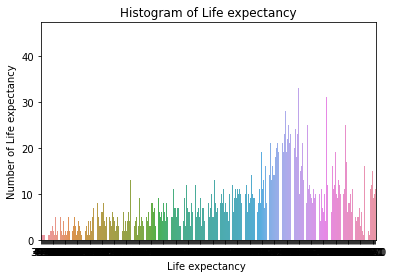

In [9]:
#Start by studying the distribution of the most important features based on your understanding of the dataset and the problem.
# Life expectancy
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
sns.countplot(x = "Life expectancy ", data = data)
plt.xlabel("Life expectancy ")
plt.ylabel("Number of Life expectancy")
plt.title("Histogram of Life expectancy")
plt.xticks( rotation = 0 ) 

Text(-9.075000000000003, 0.5, 'Number of Person')

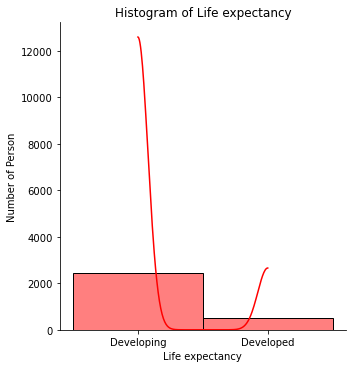

In [10]:
sns.displot(data["Status"],bins =10 , kde = True, color = "Red")
plt.title("Histogram of Life expectancy")
plt.xlabel("Life expectancy")
plt.ylabel("Number of Person")

<AxesSubplot:xlabel='Life expectancy ', ylabel='Count'>

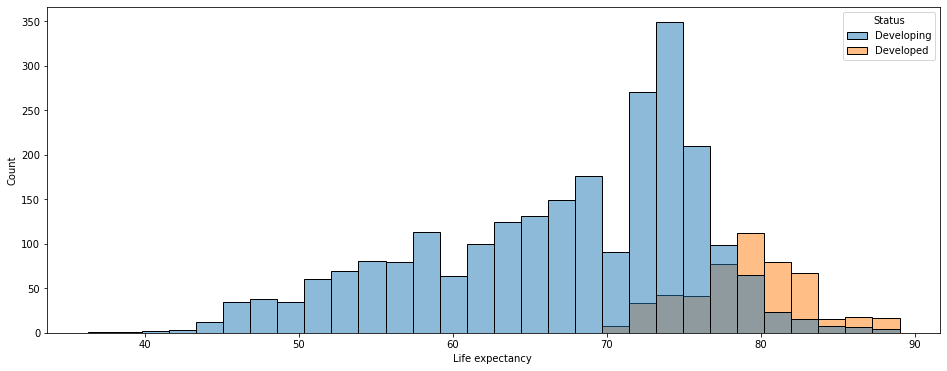

In [21]:
 s , ax = plt.subplots( figsize =( 16 , 6 ) )
sns.histplot(data=data, x="Life expectancy ",hue="Status",   ax = ax)

NameError: name 'plt' is not defined

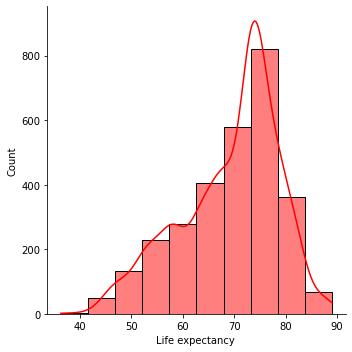

In [6]:
sns.displot(data["Life expectancy "],bins =10 , kde = True, color = "Red")
plt.title("Histogram of Life expectancy")
plt.xlabel("Life expectancy")
plt.ylabel("Number of Person")

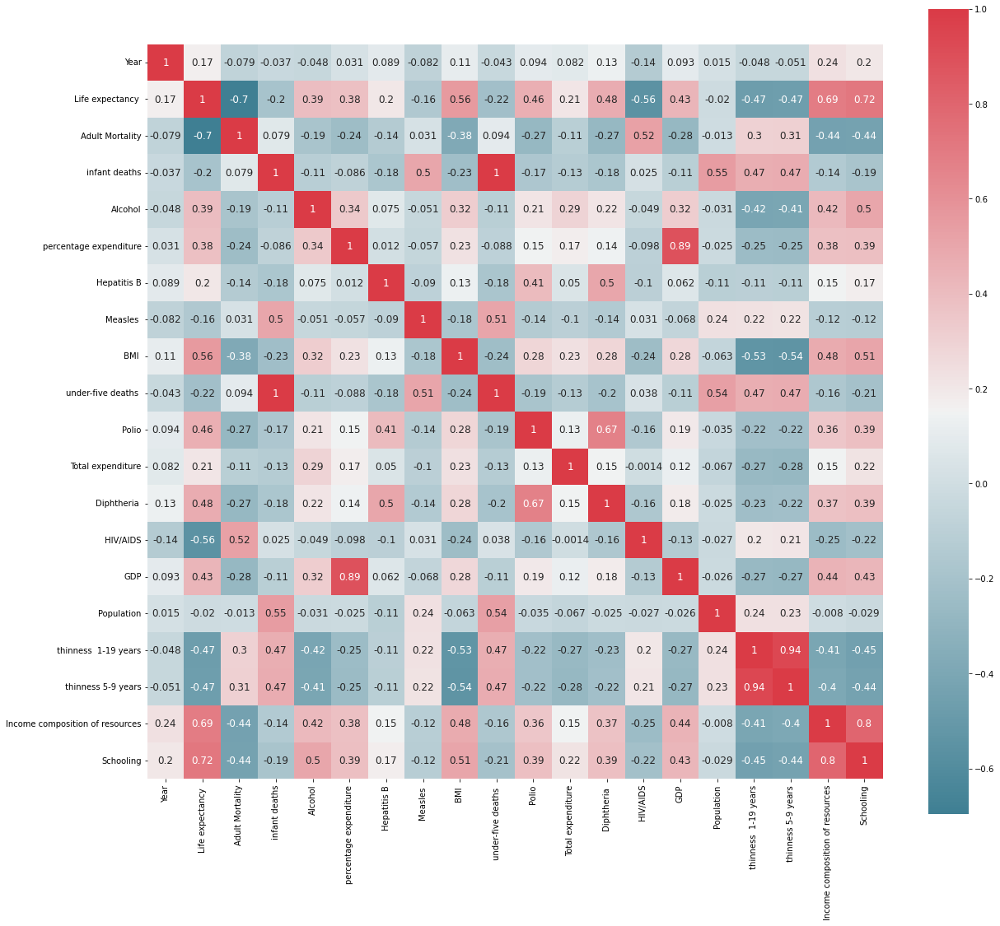

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns
def plot_correlation_map( df ):

    corr = df.corr()

    s , ax = plt.subplots( figsize =( 20 , 20 ) )

    cmap = sns.diverging_palette( 220 , 10 , as_cmap = True )

    s = sns.heatmap(corr, cmap = cmap, square=True, cbar_kws={ 'shrink' : .9 }, ax=ax, annot = True, annot_kws = { 'fontsize' : 12 })
    
plot_correlation_map(data) 

In [52]:
data.head(2)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0


In [72]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn import metrics
from sklearn.preprocessing import PolynomialFeatures 

In [98]:
#extract x and y from our data
#x=data["Adult Mortality"].values[:,np.newaxis]
#x = data[["Adult Mortality"," HIV/AIDS"," BMI ","GDP","Schooling","Income composition of resources"]]
x = data[["Adult Mortality"," HIV/AIDS"," BMI ","GDP","Schooling"]]
y=data["Life expectancy "].values

In [100]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.35,random_state=40) #splitting data with test size of 35%
lg = LinearRegression() 
poly = PolynomialFeatures(degree = 3) 
x_train_fit = poly.fit_transform(x_train) #transforming our input data
lg.fit(x_train_fit, y_train)
x_test_fit = poly.fit_transform(x_test)
predicted = lg.predict(x_test_fit)
print("MSE: ", metrics.mean_squared_error(y_test, predicted))
print("R squared: ", metrics.r2_score(y_test,predicted))

MSE:  9.605809919973888
R squared:  0.888472338874408
